# Visualize Cytomining Ecosystem Target Software Data

Visualizations related to Cytomining ecosystem software targeted project data.


In [3]:
import asyncio
import itertools
import os
import pathlib
import random
from datetime import datetime

import duckdb
import nest_asyncio
import numpy as np
import pandas as pd
import plotly.colors as pc
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import pytz
from box import Box
from itables import to_html_datatable
from pandas.api.types import CategoricalDtype
from plotly.offline import plot
from plotly.subplots import make_subplots
from pyppeteer import launch
from ydata_profiling import ProfileReport

# set plotly default theme
pio.templates.default = "simple_white"

# get the current datetime
tz = pytz.timezone("UTC")
current_datetime = datetime.now(tz)

# set common str's
title_prefix = "Cytomining Ecosystem Target Software Analysis"

# export locations relative to this notebook
export_dir = "../../docs/cytomining-ecosystem"

# set the color sequence for category-based charts
category_color_sequence = pc.qualitative.Dark2[1:6]

# set section descriptions
section_descriptions = {
    "Scholarly Papers": """
    This section helps visualize data related to how many
    scholarly papers mention or cite the target software.
    """,
    "Package Usage": """
    This section helps depict usage of the target software 
    by leveraging package data from PyPI and Conda.
    """,
    "Software Dependants": """
    This section helps show community dependants of the 
    targeted software.
    """,
    "Project Visitors": """
    This section helps show how many visitors have
    have interacted with the project over time.
    """,
}

In [67]:
# read data from various files
with duckdb.connect() as ddb:
    tgt_software_df = ddb.query(
        f"""
    SELECT
        pkgstats."Project Name",
        pubstats."Date Created Year",
        pubstats."google_scholar_count",
        pubstats."biorxiv_count",
        pubstats."total_pub_count",
        pubstats."total_pub_count_non_record_linked",
        pkgstats.pypi_downloads_total_unnested AS pypi_downloads_total,
        pkgstats.pypi_downloads_by_month,
        pkgstats.pypi_downloads_monthly_average,
        pkgstats.pypi_downloads_monthly_median,
        pkgstats.conda_downloads_total,
        pkgstats.conda_downloads_by_month,
        pkgstats.conda_downloads_monthly_average,
        pkgstats.conda_downloads_monthly_median,
        ghstats."GitHub Stars",
        ghstats."GitHub Contributor Total Count",
        ghstats."GitHub Network Count",
        ghstats."GitHub Dependency Graph Dependents Count",
        ghstats."GitHub Code Search Dependents Count",
        ghstats."GitHub Total Dependents Count",
        ghstats."GitHub Stargazers Count by Month Average",
        ghstats."GitHub Stargazers Count by Month Median",
        ghstats."GitHub Stargazers Count by Year Average",
        ghstats."GitHub Stargazers Count by Year Median"
    FROM read_parquet('data/loi-target-project-package-metrics.parquet') as pkgstats
    JOIN read_parquet('data/loi-target-project-github-metrics.parquet') as ghstats ON
        pkgstats."Project Name" = ghstats."Project Name"
    JOIN read_parquet('data/loi-target-project-publication-metrics.parquet') as pubstats ON
        pkgstats."Project Name" = pubstats."Project Name"
    """,
    ).df()
tgt_software_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3 entries, 0 to 2
Data columns (total 24 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Project Name                              3 non-null      object 
 1   Date Created Year                         3 non-null      int64  
 2   google_scholar_count                      3 non-null      int64  
 3   biorxiv_count                             3 non-null      int64  
 4   total_pub_count                           3 non-null      int64  
 5   total_pub_count_non_record_linked         3 non-null      int64  
 6   pypi_downloads_total                      3 non-null      int64  
 7   pypi_downloads_by_month                   3 non-null      object 
 8   pypi_downloads_monthly_average            2 non-null      float64
 9   pypi_downloads_monthly_median             2 non-null      float64
 10  conda_downloads_total                     

In [7]:
tgt_software_df.head()

,Project Name,Date Created Year,google_scholar_count,biorxiv_count,total_pub_count,total_pub_count_non_record_linked,pypi_downloads_total,pypi_downloads_monthly_average,pypi_downloads_monthly_median,conda_downloads_total,...,GitHub Stars,GitHub Contributor Total Count,GitHub Network Count,GitHub Dependency Graph Dependents Count,GitHub Code Search Dependents Count,GitHub Total Dependents Count,GitHub Stargazers Count by Month Average,GitHub Stargazers Count by Month Median,GitHub Stargazers Count by Year Average,GitHub Stargazers Count by Year Median
0,pycytominer,2019,20,13,21,20,103,34.300000,28.0,1277.0,...,55,22,32,9,54,58,1.037736,1.0,11.0,10.0
1,CytoSnake,2022,0,0,0,0,0,NaN,NaN,134.0,...,3,3,3,0,0,0,0.136364,0.0,1.5,1.5
2,CytoTable,2022,0,0,0,0,44,15.833333,13.0,NaN,...,4,5,5,1,6,7,0.266667,0.0,2.0,2.0


In [17]:
# create list to collect the figures for later display together
fig_collection = []

In [18]:
tgt_software_df[["google_scholar_count", "biorxiv_count"]].T[0]

google_scholar_count    20
biorxiv_count           13
Name: 0, dtype: int64

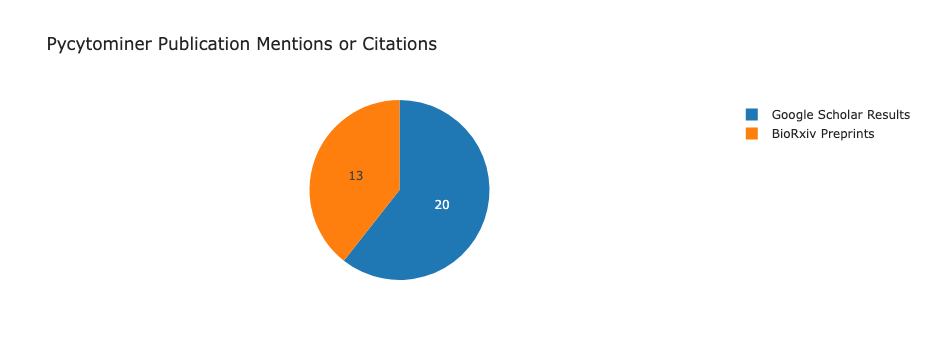

In [66]:
# Publications for target projects

fig_publications = px.pie(
    title="Pycytominer Publication Mentions or Citations",
    data_frame=tgt_software_df[["google_scholar_count", "biorxiv_count"]].T,
    values=0,
    names=["Google Scholar Results", "BioRxiv Preprints"],
    hover_name=["Google Scholar Results", "BioRxiv Preprints"],
    width=500,
)
fig_publications.update_traces(textinfo="value")

fig_collection.append(
    {
        "plot": fig_publications,
        "description": """
        This plot shows how many publications mention or cite Pycytominer
        as a reference. We used Google Scholar and BioRxiv as search resources
        for this work.
        """,
        "findings": """
        We observe that Pycytominer appears in 20 Google Scholar results and 13 BioRxiv 
        preprints. This demonstrates how Pycytominer is already being used in both
        previous and ongoing research efforts.
        """,
        "section": "Scholarly Papers",
    }
)

fig_publications.show()

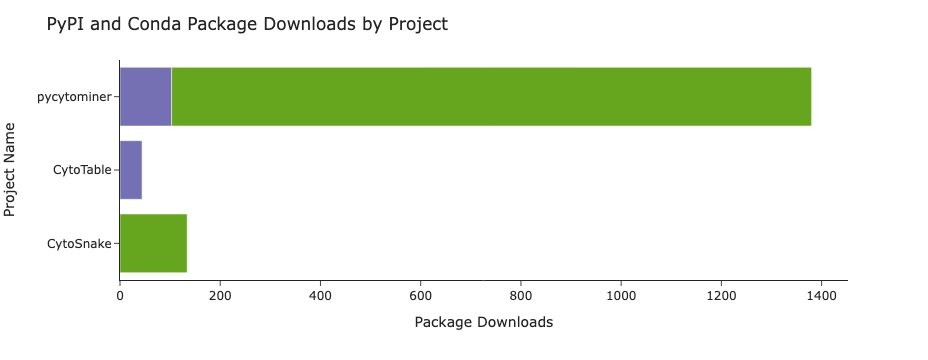

In [65]:
# vizualize package data

# Create a horizontal bar chart using Plotly Express
fig_packages = px.bar(
    data_frame=tgt_software_df.sort_values("Project Name"),
    x=["pypi_downloads_total", "conda_downloads_total"],
    y="Project Name",
    orientation="h",
    width=800,
    color_discrete_sequence=[category_color_sequence[1], category_color_sequence[3]],
)

fig_packages.update_layout(
    title="PyPI and Conda Package Downloads by Project",
    xaxis_title="Package Downloads",
    showlegend=False,
)

fig_collection.append(
    {
        "plot": fig_packages,
        "description": """
        
        """,
        "findings": (
            """
            """
        ),
        "section": "Package Usage",
    }
)

# Show the plot
fig_packages.show()

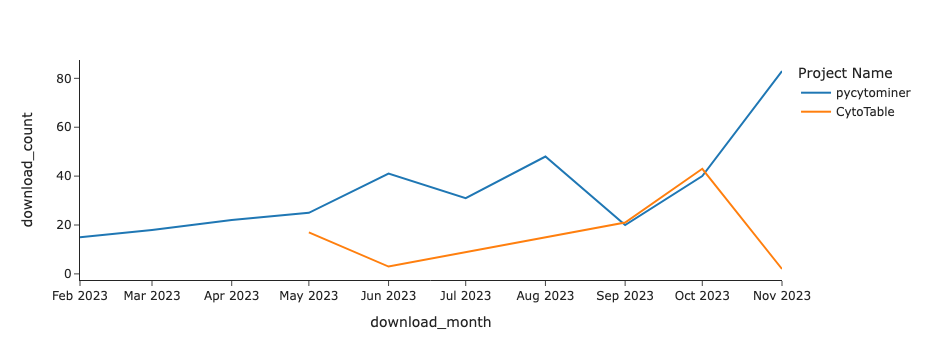

In [88]:
pypi_monthly_data = pd.concat(
    pd.DataFrame(
        [
            dict(month_entry, **{"Project Name": project_name})
            for month_entry in monthly_data
        ]
    )
    for project_name, monthly_data in zip(
        tgt_software_df["Project Name"], tgt_software_df["pypi_downloads_by_month"]
    )
)
fig_pypi_monthly = px.line(
    pypi_monthly_data, x="download_month", y="download_count", color="Project Name"
)
fig_pypi_monthly.show()

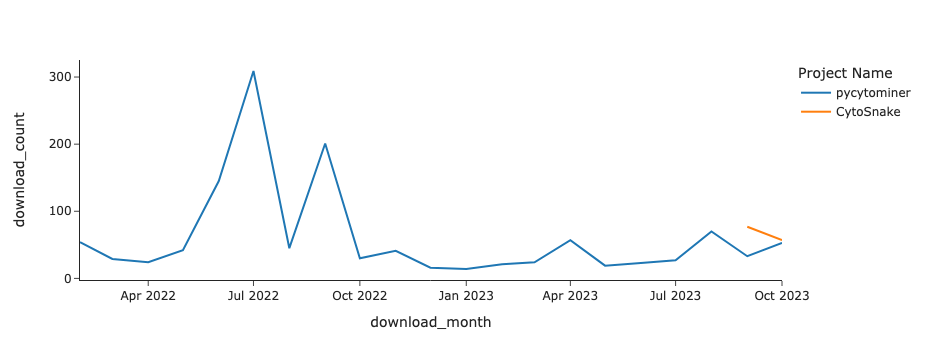

In [95]:
conda_monthly_data = pd.concat(
    pd.DataFrame(
        [
            dict(month_entry, **{"Project Name": project_name})
            for month_entry in [
                {"download_month": key, "download_count": val}
                for key, val in monthly_data.items()
            ]
        ]
    )
    for project_name, monthly_data in zip(
        tgt_software_df["Project Name"], tgt_software_df["conda_downloads_by_month"]
    )
    if isinstance(monthly_data, dict)
)
fig_conda_monthly = px.line(
    conda_monthly_data, x="download_month", y="download_count", color="Project Name"
)
fig_conda_monthly.show()

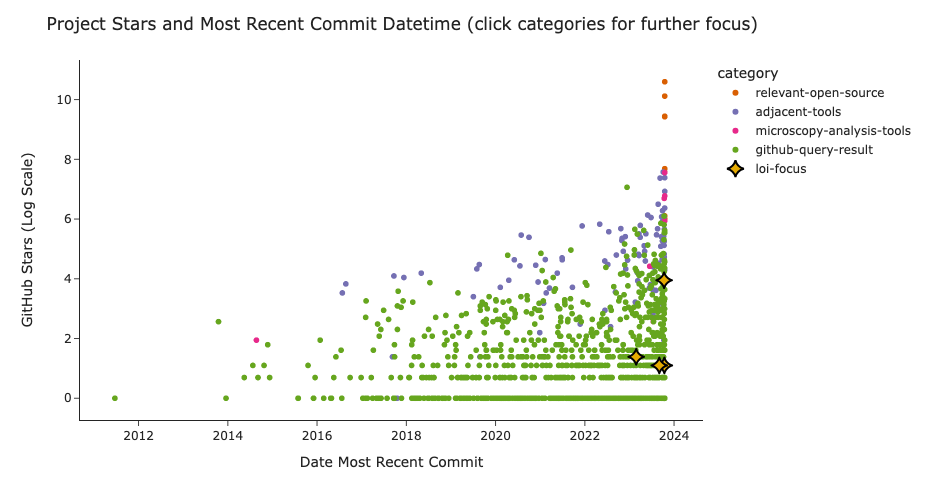

In [8]:
# scatter plot for maturity based on project

# add log of github stars to help visualize
"""df_projects["GitHub Open Issues (Log Scale)"] = np.log(
    df_projects["GitHub Open Issues"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)
"""

fig_maturity_latest_commit = px.scatter(
    df_projects[df_projects["category"] != "loi-focus"].sort_values(by="category"),
    hover_name="Project Name",
    x="Date Most Recent Commit",
    y="GitHub Stars (Log Scale)",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
    symbol="category",
    symbol_sequence=["circle", "circle", "circle", "circle"],
    render_mode="webgl",
)

# add loi-focus trace
fig_maturity_latest_commit.add_traces(
    px.scatter(
        df_projects[df_projects["category"] == "loi-focus"],
        hover_name="Project Name",
        x="Date Most Recent Commit",
        y="GitHub Stars (Log Scale)",
        width=1200,
        height=500,
        color="category",
        color_discrete_sequence=[category_color_sequence[4]],
        symbol_sequence=["star-diamond"],
        render_mode="webgl",
    )
    .update_traces(
        marker=dict(
            size=12,
            line=dict(color="black", width=2),
        )
    )
    .data
)


# customize the chart layout
fig_maturity_latest_commit.update_layout(
    title=f"Project Stars and Most Recent Commit Datetime (click categories for further focus)",
)

fig_collection.append(
    {
        "plot": fig_maturity_latest_commit,
        "description": """
        This plot demonstrates project GitHub stars and most recent commit datetime as a way to observe
        potential decay for projects which may have been popular at one point but are no longer maintained.
        """,
        "findings": """
        We find that relevant open source, microscopy analysis tools, and tools of <code>loi-focus</code> are
        all recently updated. Adjacent tools demonstrate historical usage but are somewhat less frequently maintained.
        Many tools from GitHub queries show a lack of updates for greater than 2 years.
        We hypothesize that many GitHub projects re-invent functionality related to the Cytomining Ecosystem.
        These projects are sometimes abandoned after authors perform bespoke or one-time analyses.
        """,
        "section": "Maturity",
    }
)

fig_maturity_latest_commit.show()

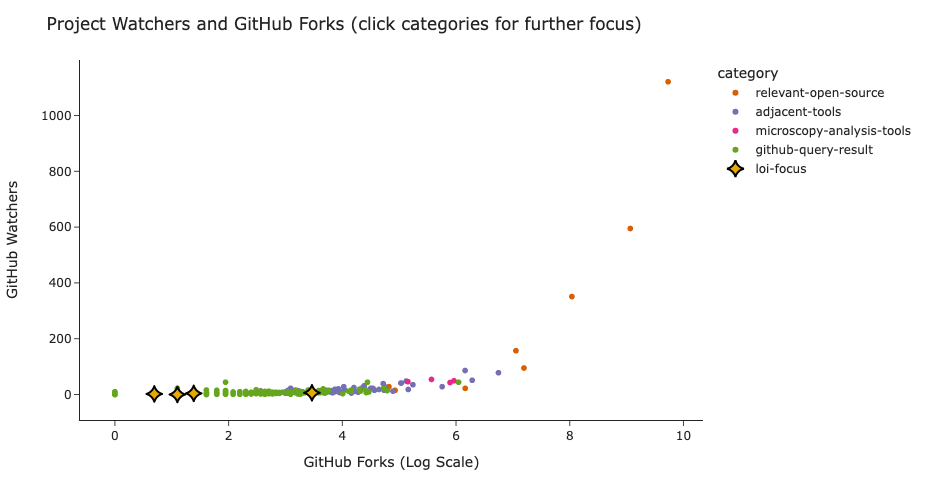

In [9]:
# scatter plot for network and subscribers

# add log of github stars to help visualize
df_projects["GitHub Forks (Log Scale)"] = np.log(
    df_projects["GitHub Forks"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)


fig_network_and_subscribers = px.scatter(
    df_projects[df_projects["category"] != "loi-focus"].sort_values(by="category"),
    hover_name="Project Name",
    x="GitHub Forks (Log Scale)",
    y="GitHub Subscribers",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
    symbol="category",
    symbol_sequence=["circle", "circle", "circle", "circle"],
    render_mode="webgl",
)

# add loi-focus trace
fig_network_and_subscribers.add_traces(
    px.scatter(
        df_projects[df_projects["category"] == "loi-focus"],
        hover_name="Project Name",
        x="GitHub Forks (Log Scale)",
        y="GitHub Subscribers",
        width=1200,
        height=500,
        color="category",
        color_discrete_sequence=[category_color_sequence[4]],
        symbol_sequence=["star-diamond"],
        render_mode="webgl",
    )
    .update_traces(
        marker=dict(
            size=12,
            line=dict(color="black", width=2),
        )
    )
    .data
)


# customize the chart layout
fig_network_and_subscribers.update_layout(
    title=f"Project Watchers and GitHub Forks (click categories for further focus)",
    xaxis_title="GitHub Forks (Log Scale)",
    yaxis_title="GitHub Watchers",
)

fig_collection.append(
    {
        "plot": fig_network_and_subscribers,
        "description": """
        This plot shows project GitHub watcher and GitHub fork count
        as a way to demonstrate relative usage.
        """,
        "findings": """
        We see a wide variety of project watcher and fork count depending on the category.
        Generally, projects of <code>loi-focus</code> are emerging tools that are at an earlier stage and thus have fewer forks and watchers.
        """,
        "section": "Usage",
    }
)

fig_network_and_subscribers.show()

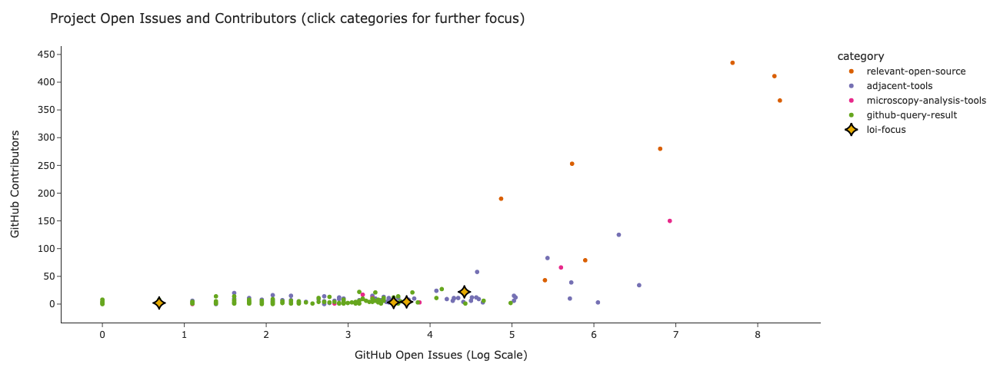

In [10]:
# scatter plot for contributors and issues

# add log of github stars to help visualize
df_projects["GitHub Open Issues (Log Scale)"] = np.log(
    df_projects["GitHub Open Issues"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)


fig_contributors_and_issues = px.scatter(
    df_projects[df_projects["category"] != "loi-focus"].sort_values(by="category"),
    hover_name="Project Name",
    x="GitHub Open Issues (Log Scale)",
    y="GitHub Contributors",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
    symbol="category",
    symbol_sequence=["circle", "circle", "circle", "circle"],
    render_mode="webgl",
)

# add loi-focus trace
fig_contributors_and_issues.add_traces(
    px.scatter(
        df_projects[df_projects["category"] == "loi-focus"],
        hover_name="Project Name",
        x="GitHub Open Issues (Log Scale)",
        y="GitHub Contributors",
        width=1200,
        height=500,
        color="category",
        color_discrete_sequence=[category_color_sequence[4]],
        symbol_sequence=["star-diamond"],
        render_mode="webgl",
    )
    .update_traces(
        marker=dict(
            size=12,
            line=dict(color="black", width=2),
        )
    )
    .data
)


# customize the chart layout
fig_contributors_and_issues.update_layout(
    title=f"Project Open Issues and Contributors (click categories for further focus)",
)

fig_collection.append(
    {
        "plot": fig_contributors_and_issues,
        "description": """
        This plot shows the number of project contributors and issue counts as a way to describe usage through maintainability.
        """,
        "findings": """
        We find that many projects have a high contributor and issue count.
        A few examples in the <code>adjacent tools</code> and <code>microscopy analysis tools</code> categories are trending toward tools
        in the <code>relevant open source</code> category.
        Projects of <code>loi-focus</code> are nearby many landscape neighbors in the middle of this plot.
        """,
        "section": "Usage",
    }
)

fig_contributors_and_issues.show()

In [11]:
# Function to find the top language for each row


def find_top_language(languages):
    if isinstance(languages, dict):
        non_empty_languages = {
            key: value for key, value in languages.items() if value is not None
        }
        if non_empty_languages:
            return max(non_empty_languages, key=non_empty_languages.get)
    return None


# Apply the function to the "GitHub Detected Languages" column and create a new column "Primary programming language"
df_projects["Primary language"] = df_projects["GitHub Detected Languages"].apply(
    find_top_language
)
df_projects[["Project Name", "Primary language"]]

,Project Name,Primary language
0,pandas,Python
1,numpy,Python
2,arrow,C++
3,duckdb,C++
4,parquet-mr,Java
...,...,...
1118,ImagingCells,Jupyter Notebook
1119,course-bia,Python
1120,Cell-virulence-Detection-using-Image-Processing,Python
1121,Image-analysis,MATLAB


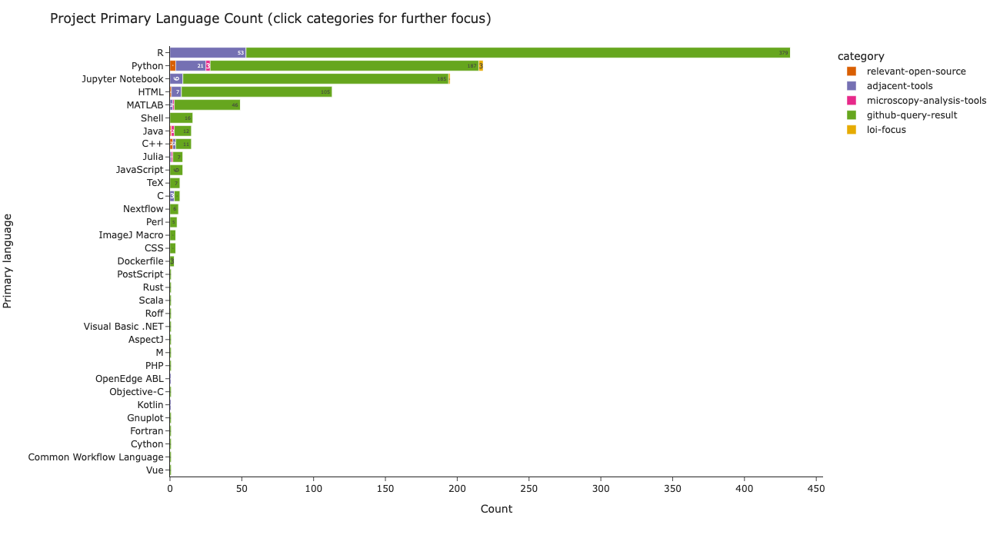

In [12]:
# Create a hbar chart for primary languages
grouped_data = (
    df_projects.groupby(["Primary language", "category"])
    .size()
    .reset_index(name="Count")
)

# Group by "Primary programming language" and calculate the sum of counts for each programming language
programming_language_counts = (
    grouped_data.groupby("Primary language")["Count"].sum().reset_index()
)

# Sort programming languages by the sum of counts in descending order
programming_language_counts = programming_language_counts.sort_values(
    by="Count", ascending=False
)


# Create a horizontal bar chart
fig_languages = px.bar(
    grouped_data.sort_values(by="category"),
    y="Primary language",
    x="Count",
    color="category",
    color_discrete_sequence=category_color_sequence,
    text="Count",
    orientation="h",
    # Sort bars by programming language counts
    category_orders={
        "Primary language": programming_language_counts["Primary language"].tolist()
    },
    width=1200,
    height=700,
)

# Customize layout to display count labels properly
fig_languages.update_traces(
    texttemplate="%{text}",
    textposition="inside",
)
fig_languages.update_layout(
    title=f"Project Primary Language Count (click categories for further focus)",
    # ensure all y axis labels appear
    yaxis=dict(
        tickmode="array",
        tickvals=programming_language_counts["Primary language"].tolist(),
        ticktext=programming_language_counts["Primary language"].tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_languages,
        "description": """
        This plot shows the primary programming language project count colored by category.
        A primary programming language is derived from the maximum lines of code from GitHub-detected programming languages.
        """,
        "findings": """
        We observe that R, Python, and Jupyter Notebooks are among the most popular primary programming languages found
        within the Cytomining Ecosystem software landscape.
        """,
        "section": "General landscape",
    }
)

# Show the plot
fig_languages.show()

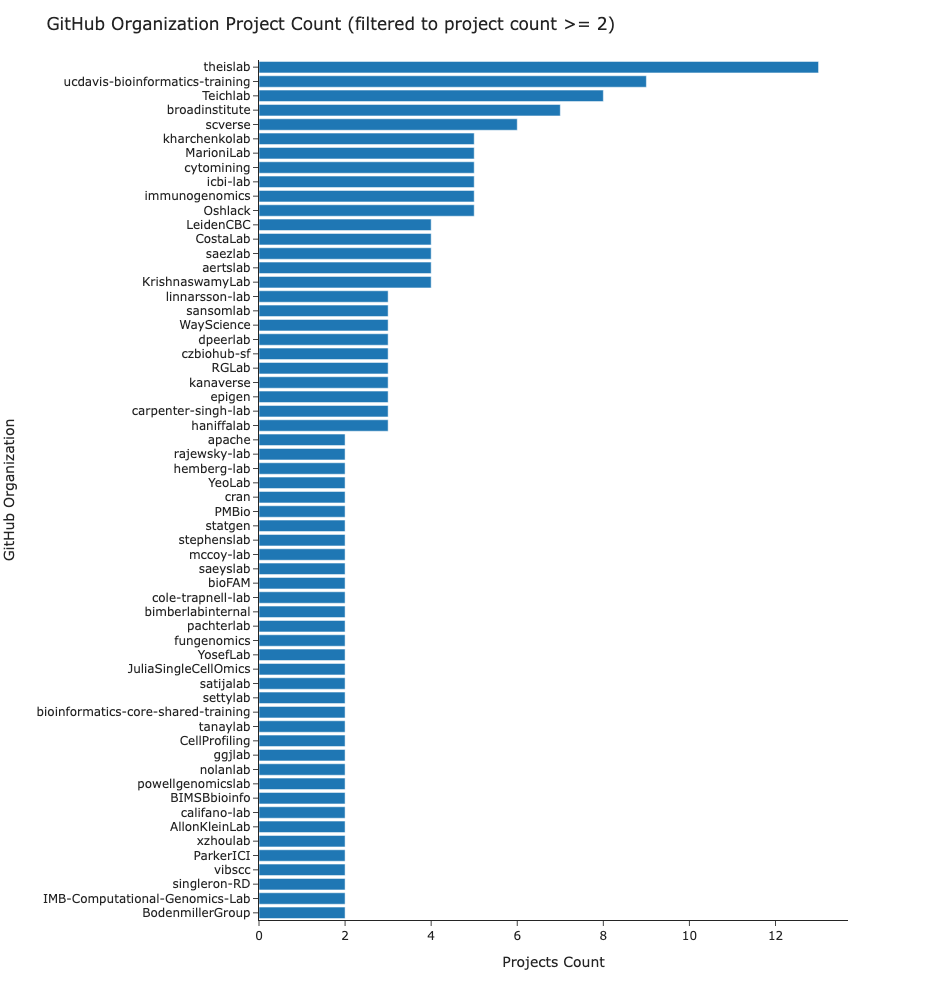

In [13]:
# gather project org data
df_project_orgs = df_projects["GitHub Organization"].value_counts()

# Create a horizontal bar chart using Plotly Express
fig_orgs = px.bar(
    df_project_orgs[df_project_orgs > 1].sort_values(ascending=True),
    orientation="h",
    width=1200,
    height=1000,
)

fig_orgs.update_layout(
    title="GitHub Organization Project Count (filtered to project count >= 2)",
    xaxis_title="Projects Count",
    showlegend=False,
    yaxis=dict(
        tickmode="array",
        tickvals=df_project_orgs.index.tolist(),
        ticktext=df_project_orgs.index.tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_orgs,
        "description": """
        This plot shows the count of projects per GitHub organization (a collection of repositories)
        for those organizations with more than 2 projects.
        """,
        "findings": (
            "Here we find that the Theis Lab, UC Davis Bioinformatics Training, and Teich Lab are at the top of this listing. "  # codespell-ignore
            "Cytomining is also near the top of the list, which is a code base that supports essential functionality that does not exist in "
            "any other open source organization that is actively maintained."
        ),
        "section": "General landscape",
    }
)

# Show the plot
fig_orgs.show()

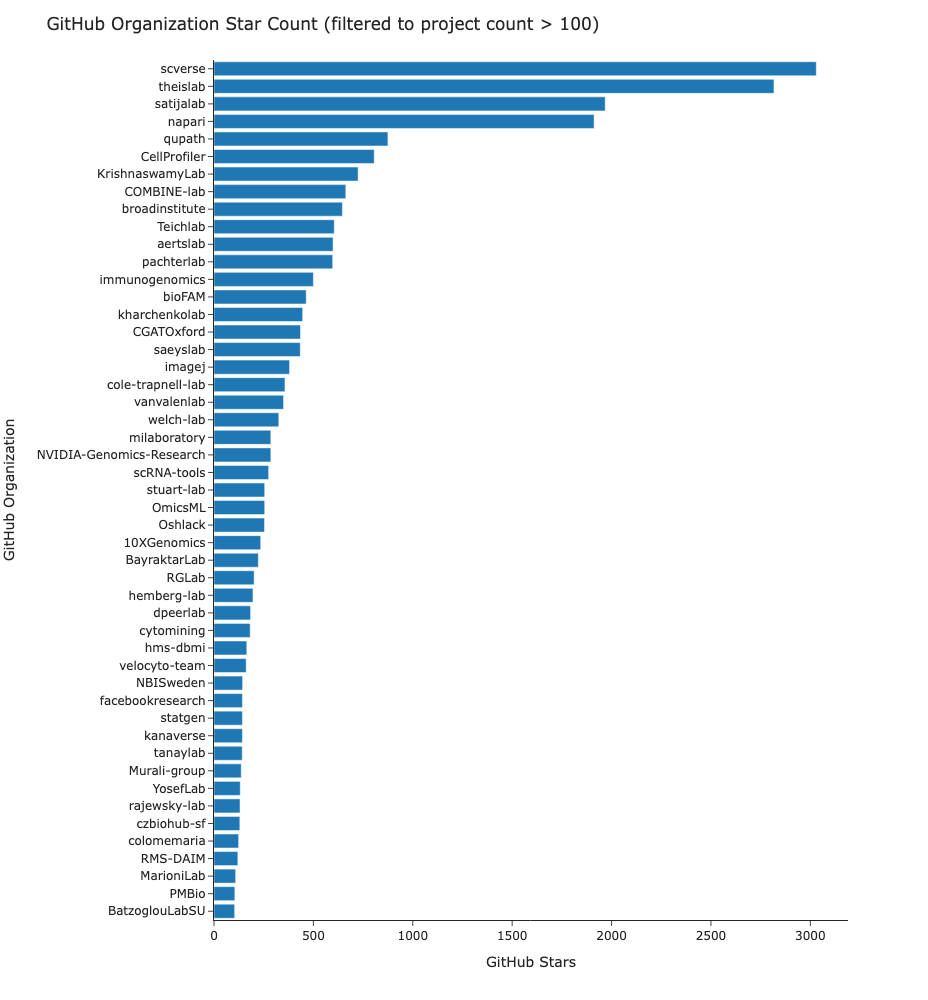

In [14]:
# gather project org data
df_project_orgs_stars = (
    df_projects[df_projects["category"] != "relevant-open-source"]
    .groupby(by=["GitHub Organization"])["GitHub Stars"]
    .sum()
)

# Create a horizontal bar chart using Plotly Express
fig_orgs_stars = px.bar(
    df_project_orgs_stars[df_project_orgs_stars > 100].sort_values(ascending=True),
    orientation="h",
    width=1200,
    height=1000,
)

fig_orgs_stars.update_layout(
    title="GitHub Organization Star Count (filtered to project count > 100)",
    xaxis_title="GitHub Stars",
    showlegend=False,
    yaxis=dict(
        tickmode="array",
        tickvals=df_project_orgs_stars.index.tolist(),
        ticktext=df_project_orgs_stars.index.tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_orgs_stars,
        "description": """
        This plot shows the sum of GitHub stars per GitHub organization for those with a sum total of stars greater than 100.
        """,
        "findings": (
            "Here we can observe that scverse, Theis Lab, and Satija Lab organizations hold the top count of GitHub stars. "  # codespell-ignore
            "The Cytomining organization is found near the middle of this visualization, indicating similar popularity and early success in audience outreach amidst those within the related landscape."
        ),
        "section": "General landscape",
    }
)

# Show the plot
fig_orgs_stars.show()

In [15]:
# create a ydata_profiling profile
profile = ProfileReport(df_projects, title=f"{title_prefix}: Data Profile")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [16]:
profile.to_file(f"{export_dir}/data_profile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
# organize figures by their sections and the order in which they appeared in this notebook
fig_collection_grouped = {
    key: [
        {
            "plot": entry["plot"],
            "description": entry["description"],
            "findings": entry["findings"],
        }
        for entry in group
    ]
    for key, group in itertools.groupby(fig_collection, key=lambda x: x["section"])
}
fig_collection_grouped.keys()

dict_keys(['User base', 'Maturity', 'Usage', 'General landscape'])

In [18]:
cdn_included = False
with open(f"{export_dir}/report.html", "w") as f:
    f.write(
        """
<html>
<!-- referenced with modifications from example work on: https://github.com/KrauseFx/markdown-to-html-github-style -->

<head>
    <title>Cytomining Ecosystem | Way Lab: Software Landscape Analysis</title>
    <meta name="viewport" content="width=device-width, initial-scale=1">
    <meta charset="UTF-8">
    <link rel="stylesheet" href="../css/style.css">
</head>

<body>
    <div id='content'>
        <h1>Cytomining Ecosystem Software Landscape Analysis - Focused Report</h1>

        <p>This is a focused report to help describe landscape elements related to project user base size, usage,
        maturity, and general landscape for the Cytomining Ecosystem.</p>

        <p>Code related to this effort may be found at: <a
                href="https://github.com/WayScience/software-landscape-analysis">https://github.com/WayScience/software-landscape-analysis</a>.
        </p>
    """
    )

    for section, figures in fig_collection_grouped.items():
        f.write(f"<h2>{section}</h2>")
        f.write(f"<p>{section_descriptions[section]}</p>")
        f.write(f"<br><br>")
        for figure in figures:
            f.write(
                figure["plot"].to_html(
                    full_html=False,
                    include_plotlyjs="cdn" if not cdn_included else False,
                )
            )
            f.write(
                f"""
            <ul>
            <li><strong>Description:</strong> {figure['description']}</li>
            <li><strong>Findings:</strong> {figure['findings']}</li>
            </ul>
            """
            )
            cdn_included = True

    f.write(
        """
    <h2>Table with selected dataset columns</h2>
    <p>The table below may be used to search and view a selected number of columns from the dataset.</p>
    """
    )

    # write an itable to the page
    f.write(
        to_html_datatable(
            df_projects[
                [
                    "Project Name",
                    "Project Repo URL",
                    "GitHub Stars",
                    "GitHub Forks",
                    "GitHub Subscribers",
                    "GitHub Open Issues",
                    "GitHub Contributors",
                    "Date Created",
                    "category",
                    "Primary language",
                ]
            ],
            style="height:600px;float:left;",
            classes="display",
            maxBytes=0,
            # fix a malformed attributes error built into the html content
        ).replace('class="display"style="', 'class="display" style="')
    )
    f.write("</div></body></html>")

In [19]:
# capture the html page as a png export as a backup

# allow for nested asyncio ops
nest_asyncio.apply()


# define function for pyppeteer to capture image
# see: https://github.com/pyppeteer/pyppeteer#examples
async def capture_screenshot(file_path, output_path):
    browser = await launch(headless=True)
    page = await browser.newPage()
    # set the size of the capture
    await page.setViewport({"width": 1400, "height": 8700})
    await page.goto(f"file://{file_path}")

    await page.screenshot({"path": output_path})
    await browser.close()


# Capture screenshot from html page
asyncio.get_event_loop().run_until_complete(
    capture_screenshot(
        file_path=pathlib.Path(f"{export_dir}/report.html").resolve(),
        output_path=f"{export_dir}/report.png",
    )
)